In [ ]:
# Import những thư viện cần thiết
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from scipy.stats import norm, boxcox
from scipy import stats

# Chuẩn bị dữ liệu

## Import những thư viện cần thiết

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from plotly import express as px

from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score

In [ ]:
df = pd.read_csv('melb_data.csv')
df.head(10)

,Suburb,Address,Rooms,Type,Price,Method,SellerG,Date,Distance,Postcode,Bedroom2,Bathroom,Car,Landsize,BuildingArea,YearBuilt,CouncilArea,Lattitude,Longtitude,Regionname,Propertycount
0,Abbotsford,85 Turner St,2,h,1480000.0,S,Biggin,3/12/2016,2.5,3067.0,2.0,1.0,1.0,202.0,NaN,NaN,Yarra,-37.7996,144.9984,Northern Metropolitan,4019.0
1,Abbotsford,25 Bloomburg St,2,h,1035000.0,S,Biggin,4/02/2016,2.5,3067.0,2.0,1.0,0.0,156.0,79.0,1900.0,Yarra,-37.8079,144.9934,Northern Metropolitan,4019.0
2,Abbotsford,5 Charles St,3,h,1465000.0,SP,Biggin,4/03/2017,2.5,3067.0,3.0,2.0,0.0,134.0,150.0,1900.0,Yarra,-37.8093,144.9944,Northern Metropolitan,4019.0
3,Abbotsford,40 Federation La,3,h,850000.0,PI,Biggin,4/03/2017,2.5,3067.0,3.0,2.0,1.0,94.0,NaN,NaN,Yarra,-37.7969,144.9969,Northern Metropolitan,4019.0
4,Abbotsford,55a Park St,4,h,1600000.0,VB,Nelson,4/06/2016,2.5,3067.0,3.0,1.0,2.0,120.0,142.0,2014.0,Yarra,-37.8072,144.9941,Northern Metropolitan,4019.0
5,Abbotsford,129 Charles St,2,h,941000.0,S,Jellis,7/05/2016,2.5,3067.0,2.0,1.0,0.0,181.0,NaN,NaN,Yarra,-37.8041,144.9953,Northern Metropolitan,4019.0
6,Abbotsford,124 Yarra St,3,h,1876000.0,S,Nelson,7/05/2016,2.5,3067.0,4.0,2.0,0.0,245.0,210.0,1910.0,Yarra,-37.8024,144.9993,Northern Metropolitan,4019.0
7,Abbotsford,98 Charles St,2,h,1636000.0,S,Nelson,8/10/2016,2.5,3067.0,2.0,1.0,2.0,256.0,107.0,1890.0,Yarra,-37.8060,144.9954,Northern Metropolitan,4019.0
8,Abbotsford,6/241 Nicholson St,1,u,300000.0,S,Biggin,8/10/2016,2.5,3067.0,1.0,1.0,1.0,0.0,NaN,NaN,Yarra,-37.8008,144.9973,Northern Metropolitan,4019.0
9,Abbotsford,10 Valiant St,2,h,1097000.0,S,Biggin,8/10/2016,2.5,3067.0,3.0,1.0,2.0,220.0,75.0,1900.0,Yarra,-37.8010,144.9989,Northern Metropolitan,4019.0


## Mô tả bộ dữ liệu

**Data Description:**
- Suburb: Vị trí ngôi nhà ở vùng ngoại ô
- Address: Địa chỉ nhà 
- Rooms: Số phòng
- Type: Thể loại nhà
- Price: Giá tính bằng đô la
- Method: Tình trạng của các ngôi nhà
- SellerG: Đại lý bất động sản
- Date: Ngày bán
- Distance: Khoảng cách từ CBD
- Postcode: mã ngôi nhà
- Bedroom2: Số lượng phòng ngủ
- Bathroom: Số lượng phòng tắm
- Car: Số lượng ô tô
- Landsize: Diện tích đất
- BuildingArea: Kích thước tòa nhà
- YearBuilt: Năm Xây dựng
- CouncilArea: Hội đồng quản trị khu vực
- Lattitude: Vĩ độ
- Longtitude: Kinh độ
- Regionname: Tên khu vực 
- Propertycount: Số lượng bất động sản còn lại ở vùng ngoại ô


In [ ]:
nRows, nCols = df.shape
print(f"Trong bộ dữ liệu trên ta có {nRows} hàng và {nCols} cột")

Trong bộ dữ liệu trên ta có 13580 hàng và 21 cột


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13580 entries, 0 to 13579
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Suburb         13580 non-null  object 
 1   Address        13580 non-null  object 
 2   Rooms          13580 non-null  int64  
 3   Type           13580 non-null  object 
 4   Price          13580 non-null  float64
 5   Method         13580 non-null  object 
 6   SellerG        13580 non-null  object 
 7   Date           13580 non-null  object 
 8   Distance       13580 non-null  float64
 9   Postcode       13580 non-null  float64
 10  Bedroom2       13580 non-null  float64
 11  Bathroom       13580 non-null  float64
 12  Car            13518 non-null  float64
 13  Landsize       13580 non-null  float64
 14  BuildingArea   7130 non-null   float64
 15  YearBuilt      8205 non-null   float64
 16  CouncilArea    12211 non-null  object 
 17  Lattitude      13580 non-null  float64
 18  Longti

### Thống kê mô tả các cột định lượng

In [ ]:
df.describe()

,Rooms,Price,Distance,Postcode,Bedroom2,Bathroom,Car,Landsize,BuildingArea,YearBuilt,Lattitude,Longtitude,Propertycount
count,13580.000000,1.358000e+04,13580.000000,13580.000000,13580.000000,13580.000000,13518.000000,13580.000000,7130.000000,8205.000000,13580.000000,13580.000000,13580.000000
mean,2.937997,1.075684e+06,10.137776,3105.301915,2.914728,1.534242,1.610075,558.416127,151.967650,1964.684217,-37.809203,144.995216,7454.417378
std,0.955748,6.393107e+05,5.868725,90.676964,0.965921,0.691712,0.962634,3990.669241,541.014538,37.273762,0.079260,0.103916,4378.581772
min,1.000000,8.500000e+04,0.000000,3000.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1196.000000,-38.182550,144.431810,249.000000
25%,2.000000,6.500000e+05,6.100000,3044.000000,2.000000,1.000000,1.000000,177.000000,93.000000,1940.000000,-37.856822,144.929600,4380.000000
50%,3.000000,9.030000e+05,9.200000,3084.000000,3.000000,1.000000,2.000000,440.000000,126.000000,1970.000000,-37.802355,145.000100,6555.000000
75%,3.000000,1.330000e+06,13.000000,3148.000000,3.000000,2.000000,2.000000,651.000000,174.000000,1999.000000,-37.756400,145.058305,10331.000000
max,10.000000,9.000000e+06,48.100000,3977.000000,20.000000,8.000000,10.000000,433014.000000,44515.000000,2018.000000,-37.408530,145.526350,21650.000000


### Thống kê mô tả các cột định tính

In [ ]:
df.describe(include='object')

,Suburb,Address,Type,Method,SellerG,Date,CouncilArea,Regionname
count,13580,13580,13580,13580,13580,13580,12211,13580
unique,314,13378,3,5,268,58,33,8
top,Reservoir,28 Blair St,h,S,Nelson,27/05/2017,Moreland,Southern Metropolitan
freq,359,3,9449,9022,1565,473,1163,4695


# Xử lí dữ liệu

In [ ]:
df.nunique()

Suburb             314
Address          13378
Rooms                9
Type                 3
Price             2204
Method               5
SellerG            268
Date                58
Distance           202
Postcode           198
Bedroom2            12
Bathroom             9
Car                 11
Landsize          1448
BuildingArea       602
YearBuilt          144
CouncilArea         33
Lattitude         6503
Longtitude        7063
Regionname           8
Propertycount      311
dtype: int64

## Missing values

- **Chuyển các giá trị 0 ở thuộc tính BuildingArea và Landsize thành giá trị Nan**

In [ ]:
df['BuildingArea'].replace(to_replace=0, value = np.nan, inplace=True)

In [ ]:
df['Landsize'].replace(to_replace=0, value = np.nan, inplace=True)

- **Sử dụng biểu đồ để trực quan missing values**

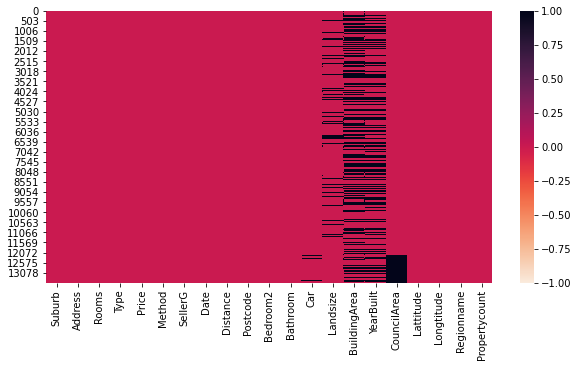

In [ ]:
plt.subplots(figsize=(10,5))
sns.heatmap(df.isna(), vmin=-1, vmax=1, cmap='rocket_r')

Có 5 thuộc tính bị thiếu dữ liệu là BuildingArea, YearBuilt, CouncilArea, Car, Landsize

- **Số lượng dữ liệu bị thiếu**

In [ ]:
df.isna().sum().sort_values(ascending=False).head(5)

BuildingArea    6467
YearBuilt       5375
Landsize        1939
CouncilArea     1369
Car               62
dtype: int64

- **Tỷ lệ dữ liệu bị thiếu**

In [ ]:
(df.isna().sum() * 100 / df.isna().count()).round(2).sort_values(ascending=False).head(5)

BuildingArea    47.62
YearBuilt       39.58
Landsize        14.28
CouncilArea     10.08
Car              0.46
dtype: float64

In [ ]:
df[['BuildingArea', 'YearBuilt', 'CouncilArea', 'Car', 'Landsize']].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13580 entries, 0 to 13579
Data columns (total 5 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   BuildingArea  7113 non-null   float64
 1   YearBuilt     8205 non-null   float64
 2   CouncilArea   12211 non-null  object 
 3   Car           13518 non-null  float64
 4   Landsize      11641 non-null  float64
dtypes: float64(4), object(1)
memory usage: 530.6+ KB


Trong 5 thuộc tính BuildingArea, YearBuilt, CouncilArea, Car, Landsize có 4 thuộc tính dạng ***float*** và 1 thuộc tính ***object***

- **Thay thế dữ liệu bằng phương pháp imputation cho các thuộc tính số**

In [ ]:
# Tìm kiếm các thuộc tính số (numeric features)
numeric_features = df.select_dtypes(['int', 'float']).columns
numeric_features

Index(['Rooms', 'Price', 'Distance', 'Postcode', 'Bedroom2', 'Bathroom', 'Car',
       'Landsize', 'BuildingArea', 'YearBuilt', 'Lattitude', 'Longtitude',
       'Propertycount'],
      dtype='object')

In [ ]:
from sklearn.impute import SimpleImputer
my_imputer = SimpleImputer()
new_data = pd.DataFrame(my_imputer.fit_transform(df[numeric_features]))
new_data.columns = df[numeric_features].columns

In [ ]:
new_data['YearBuilt'] = new_data['YearBuilt'].round(0)
df[numeric_features] = new_data
df[numeric_features]

,Rooms,Price,Distance,Postcode,Bedroom2,Bathroom,Car,Landsize,BuildingArea,YearBuilt,Lattitude,Longtitude,Propertycount
0,2.0,1480000.0,2.5,3067.0,2.0,1.0,1.0,202.0,152.330851,1965.0,-37.79960,144.99840,4019.0
1,2.0,1035000.0,2.5,3067.0,2.0,1.0,0.0,156.0,79.000000,1900.0,-37.80790,144.99340,4019.0
2,3.0,1465000.0,2.5,3067.0,3.0,2.0,0.0,134.0,150.000000,1900.0,-37.80930,144.99440,4019.0
3,3.0,850000.0,2.5,3067.0,3.0,2.0,1.0,94.0,152.330851,1965.0,-37.79690,144.99690,4019.0
4,4.0,1600000.0,2.5,3067.0,3.0,1.0,2.0,120.0,142.000000,2014.0,-37.80720,144.99410,4019.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
13575,4.0,1245000.0,16.7,3150.0,4.0,2.0,2.0,652.0,152.330851,1981.0,-37.90562,145.16761,7392.0
13576,3.0,1031000.0,6.8,3016.0,3.0,2.0,2.0,333.0,133.000000,1995.0,-37.85927,144.87904,6380.0
13577,3.0,1170000.0,6.8,3016.0,3.0,2.0,4.0,436.0,152.330851,1997.0,-37.85274,144.88738,6380.0
13578,4.0,2500000.0,6.8,3016.0,4.0,1.0,5.0,866.0,157.000000,1920.0,-37.85908,144.89299,6380.0


- **Thay thế dữ liệu**
> Thay thế các thuộc tính BuildingArea , YearBuilt, Car, Landsize bằng giá trị ***trung bình*** của từng thuộc tính đó, riêng thuộc tính CouncilArea thì thay thế bằng ***mode()***

In [ ]:
df['CouncilArea'] = df['CouncilArea'].fillna(df['CouncilArea'].mode()[0])

- Dữ liệu sau khi đã được xử lý missing values

In [ ]:
print(df.isna().any())

Suburb           False
Address          False
Rooms            False
Type             False
Price            False
Method           False
SellerG          False
Date             False
Distance         False
Postcode         False
Bedroom2         False
Bathroom         False
Car              False
Landsize         False
BuildingArea     False
YearBuilt        False
CouncilArea      False
Lattitude        False
Longtitude       False
Regionname       False
Propertycount    False
dtype: bool


## Outlier

- Tiến hành xử lý outlier cho thuộc tính **Price**

> Trước khi chưa xử lý outlier

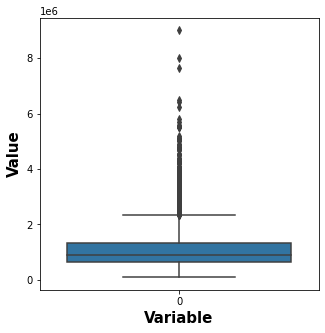

In [ ]:
plt.subplots(figsize=(5,5))
sns.boxplot(data=df['Price'])
plt.xlabel('Variable', weight='bold', fontsize=15)
plt.ylabel('Value', weight='bold', fontsize=15)
plt.show()

In [ ]:
def outliers(df):
    q1,q3 = df.describe().loc[['25%','75%']]['Price'].values
    iqr = q3 - q1
    return df[(df['Price'] >= q1 - 1.5 *iqr) & (df['Price'] <= q3 +  1.5 *iqr)]

In [ ]:
df = outliers(df)

> Sau khi xử lý oulier

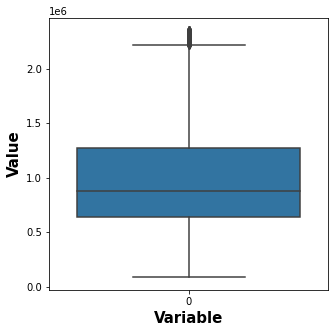

In [ ]:
plt.subplots(figsize=(5,5))
sns.boxplot(data=df['Price'])
plt.xlabel('Variable', weight='bold', fontsize=15)
plt.ylabel('Value', weight='bold', fontsize=15)
plt.show()

## Thuộc tính Address

In [ ]:
print(df['Address'].head(), end='\n\n')
print(df['Address'].nunique())

0        85 Turner St
1     25 Bloomburg St
2        5 Charles St
3    40 Federation La
4         55a Park St
Name: Address, dtype: object

12782


In [ ]:
df['Address'] = df['Address'].str.replace('[0-9]{1,3}[a-z]{0,3}|[/]','')

In [ ]:
print(df['Address'].head(), end='\n\n')
print(df['Address'].nunique())

0         Turner St
1      Bloomburg St
2        Charles St
3     Federation La
4           Park St
Name: Address, dtype: object

5276


In [ ]:
nRows, nCols = df.shape
print(f"Bộ dữ liệu sau khi xử lí ta có {nRows} hàng và {nCols} cột")

Bộ dữ liệu sau khi xử lí ta có 12968 hàng và 21 cột


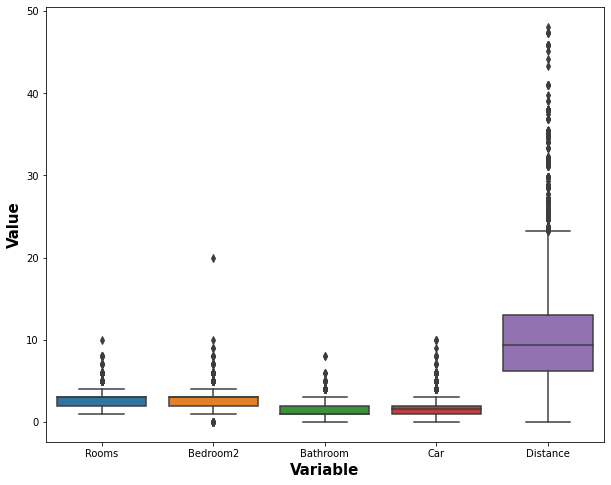

In [ ]:
plt.subplots(figsize=(10,8))
sns.boxplot(data=df[['Rooms','Bedroom2','Bathroom','Car','Distance']].melt(), x='variable', y='value')
plt.xlabel('Variable', weight='bold', fontsize=15)
plt.ylabel('Value', weight='bold', fontsize=15)
plt.show()

# Khai thác dữ liệu

## Các thuộc tính phân loại (Caterogical features)

In [ ]:
categorical_features = df.select_dtypes(include='object').columns

categorical_features, len(categorical_features)

(Index(['Suburb', 'Address', 'Type', 'Method', 'SellerG', 'Date', 'CouncilArea',
        'Regionname'],
       dtype='object'), 8)

In [ ]:
for i in categorical_features:
  print('Tổng số lượng các LOẠI dữ liệu trong ' + i + ' : ', len(df[i].unique()))

Tổng số lượng các LOẠI dữ liệu trong Suburb :  314
Tổng số lượng các LOẠI dữ liệu trong Address :  5276
Tổng số lượng các LOẠI dữ liệu trong Type :  3
Tổng số lượng các LOẠI dữ liệu trong Method :  5
Tổng số lượng các LOẠI dữ liệu trong SellerG :  265
Tổng số lượng các LOẠI dữ liệu trong Date :  58
Tổng số lượng các LOẠI dữ liệu trong CouncilArea :  33
Tổng số lượng các LOẠI dữ liệu trong Regionname :  8


***Số lượng của mỗi loại dữ liệu riêng biệt trong các thuộc tính phân loại***

In [ ]:
for idx, column in enumerate(categorical_features):
    df_temp = df.copy()
    
    unique = df_temp[column].value_counts().reset_index().rename(columns={"index": column, column: "Số lượng"});
    unique = unique.sort_values("Số lượng", ascending=False);
    print('\n\n', unique.head(10), end='\n...\n')

    fig = px.bar(unique,
                 x=column, y='Số lượng',
                 color_discrete_sequence=px.colors.qualitative.D3,
                 height=350,
                 width=550,
                 title="Số lượng của từng loại dữ liệu trong thuộc tính: "+column
                 )
    fig.show()



            Suburb  Số lượng
0       Reservoir       359
1        Richmond       253
2  Bentleigh East       249
3         Preston       239
4       Brunswick       220
5        Essendon       216
6          Coburg       190
7     South Yarra       190
8       Northcote       183
9     Pascoe Vale       171
...




          Address  Số lượng
0      Barkly St        74
1        High St        54
2   Dandenong Rd        43
3    Victoria St        40
4     Charles St        39
5     The Avenue        38
6      Toorak Rd        36
7      Gordon St        34
8       North Rd        34
9     William St        33
...




   Type  Số lượng
0    h      8851
1    u      3014
2    t      1103
...




   Method  Số lượng
0      S      8644
1     SP      1669
2     PI      1470
3     VB      1095
4     SA        90
...




          SellerG  Số lượng
0         Nelson      1549
1         Jellis      1196
2  hockingstuart      1145
3          Barry      1005
4            Ray       698
5         Buxton       605
6       Marshall       481
7         Biggin       379
8           Brad       339
9       Woodards       297
...




          Date  Số lượng
0  27/05/2017       449
1   3/06/2017       380
2  12/08/2017       360
3  17/06/2017       358
4  27/11/2016       335
5  29/07/2017       332
6   4/03/2017       321
7  24/06/2017       316
8  22/07/2017       313
9  25/02/2017       313
...




      CouncilArea  Số lượng
0       Moreland      2449
1  Moonee Valley       986
2     Boroondara       951
3        Darebin       927
4      Glen Eira       836
5    Maribyrnong       691
6    Stonnington       635
7          Yarra       626
8   Port Phillip       587
9        Banyule       578
...




                    Regionname  Số lượng
0       Southern Metropolitan      4185
1       Northern Metropolitan      3848
2        Western Metropolitan      2925
3        Eastern Metropolitan      1437
4  South-Eastern Metropolitan       447
5            Eastern Victoria        53
6           Northern Victoria        41
7            Western Victoria        32
...


***Giá BDS trung bình của từng loại dữ liệu trong các thuộc tính phân loại***

In [ ]:
for idx, column in enumerate(categorical_features):
    df_temp = df.copy()
    
    unique = df_temp.loc[:, [column, 'Price']].groupby(column).mean().reset_index();
    unique = unique.sort_values("Price", ascending=False)
    print('\n\n', unique.head(5), end='\n...\n')

    fig = px.bar(unique,
                 x=column, y='Price',
                 color_discrete_sequence=px.colors.qualitative.Dark2,
                 height=350,
                 width=550,
                 title="Giá trung bình của BĐS trong: "+column
                 )
    fig.show()



            Suburb         Price
235  Princes Hill  1.734600e+06
4     Albert Park  1.664336e+06
171      Kew East  1.648851e+06
13      Ashburton  1.609380e+06
22   Balwyn North  1.606434e+06
...




              Address      Price
1408      Dudley Pde  2350000.0
1057         Como St  2345000.0
3980   Rostrevor Pde  2335000.0
4905     Winmalee Rd  2330000.0
4968    Wynnewood Ct  2330000.0
...




   Type         Price
0    h  1.120278e+06
1    t  9.156195e+05
2    u  6.029146e+05
...




   Method         Price
0     PI  1.008705e+06
1      S  1.001724e+06
4     VB  9.888959e+05
2     SA  9.824556e+05
3     SP  8.566389e+05
...




     SellerG      Price
160   North  2200000.0
24     Blue  2180000.0
231   Upper  2100000.0
245   White  2035000.0
118     LLC  2020000.0
...




           Date         Price
15  16/09/2017  1.102169e+06
8   13/05/2017  1.102084e+06
57   9/09/2017  1.098592e+06
20  19/08/2017  1.090158e+06
33  26/08/2017  1.084028e+06
...




     CouncilArea         Price
1       Bayside  1.366522e+06
2    Boroondara  1.330563e+06
27  Unavailable  1.325000e+06
15   Manningham  1.216971e+06
28   Whitehorse  1.183001e+06
...




                    Regionname         Price
5       Southern Metropolitan  1.165591e+06
0        Eastern Metropolitan  1.065194e+06
4  South-Eastern Metropolitan  8.968673e+05
2       Northern Metropolitan  8.751220e+05
6        Western Metropolitan  8.517719e+05
...


## Các thuộc tính số(Numeric features)

In [ ]:
numeric_features , len(numeric_features)

(Index(['Rooms', 'Price', 'Distance', 'Postcode', 'Bedroom2', 'Bathroom', 'Car',
        'Landsize', 'BuildingArea', 'YearBuilt', 'Lattitude', 'Longtitude',
        'Propertycount'],
       dtype='object'), 13)

### Mức độ đóng góp
> Tác động mạnh, yếu về chiều dương hoặc chiều âm

In [ ]:
# Xoá thuộc tính Price ra khỏi numeric_features
numeric_features = numeric_features.drop('Price')

In [ ]:
X = df[numeric_features]
y = df[['Price']]

In [ ]:
from scipy import stats
import statsmodels.api as sm

# Chuẩn hóa dữ liệu
X_norm = pd.DataFrame(stats.zscore(X),columns=X.columns)
X_norm = sm.add_constant(X_norm)
y_norm = pd.DataFrame(stats.zscore(y), columns=['zscore'])

model_stand_res = sm.OLS(y_norm, X_norm).fit()

print(model_stand_res.summary())

/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning:

pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.



                            OLS Regression Results                            
Dep. Variable:                 zscore   R-squared:                       0.531
Model:                            OLS   Adj. R-squared:                  0.531
Method:                 Least Squares   F-statistic:                     1223.
Date:                Sat, 04 Sep 2021   Prob (F-statistic):               0.00
Time:                        12:22:08   Log-Likelihood:                -13489.
No. Observations:               12968   AIC:                         2.700e+04
Df Residuals:                   12955   BIC:                         2.710e+04
Df Model:                          12                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const          3.625e-14      0.006   6.03e-12

In [ ]:
coeff = model_stand_res.params

coeff = coeff.iloc[(coeff.abs()*(-1.0)).argsort()]
print(coeff)

Distance        -4.425970e-01
Rooms            4.120194e-01
YearBuilt       -2.160557e-01
Lattitude       -1.792905e-01
Longtitude       1.640426e-01
Bathroom         1.346983e-01
Postcode         1.071011e-01
Car              9.519164e-02
Bedroom2         8.570401e-02
BuildingArea     4.363075e-02
Propertycount   -4.064833e-02
Landsize        -7.853958e-03
const            3.625399e-14
dtype: float64


/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



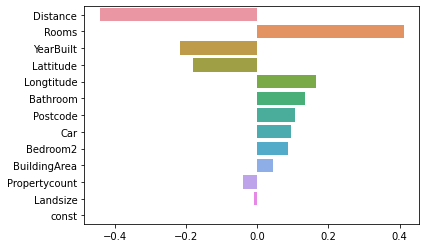

In [ ]:
sns.barplot(coeff.values, coeff.index, orient='h')

## Data visualization

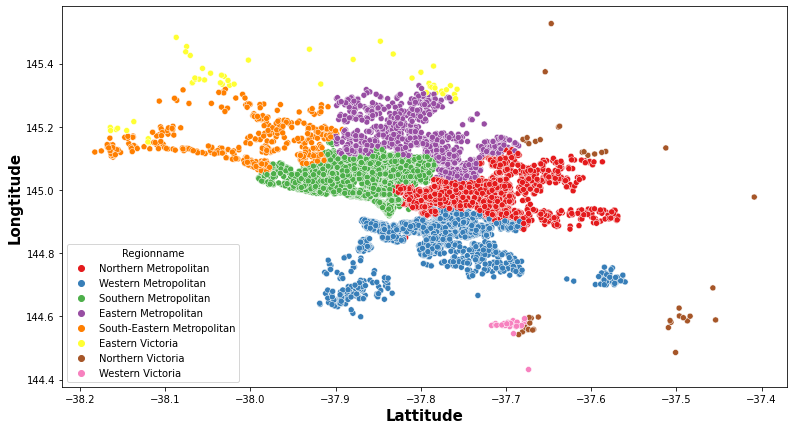

In [ ]:
plt.subplots(figsize=(13,7))
sns.scatterplot(x=df['Lattitude'], y=df['Longtitude'], hue=df['Regionname'], palette='Set1')
plt.xlabel('Lattitude', weight='bold', fontsize=15)
plt.ylabel('Longtitude', weight='bold', fontsize=15)
plt.show()

In [ ]:
#Vẽ biểu đồ Map
import folium
from folium.plugins import MarkerCluster

map = folium.Map(location = [-37.65,145.2])
map.save('map_price.html')
marker_cluster_intersection = MarkerCluster().add_to(map)
for index, row in df.iterrows():
    folium.Marker([row['Lattitude'],
                   row['Longtitude']] ,
                   popup = ('<strong>Address</strong>: ' + str(row['Address']) + '<br>'
                            '<strong>Price</strong>: ' + str(row['Price']) + '<br>'
                            '<strong>Regionname</strong>: ' + str(row['Regionname']) + '<br>')).add_to(marker_cluster_intersection )
map.save('map_price.html')
map

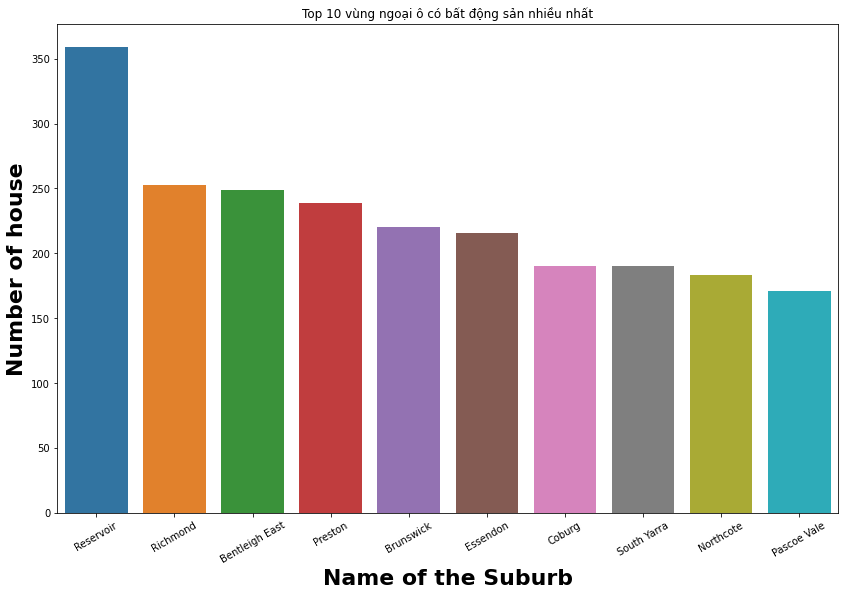

In [ ]:
Suburb = df.Suburb.value_counts()
Suburb = Suburb.head(10)
plt.subplots(figsize=(14,9))
sns.countplot(x=df.Suburb, order=Suburb.index)
plt.xlabel('Name of the Suburb', weight='bold', fontsize=22)
plt.ylabel('Number of house', weight='bold', fontsize=22)
plt.title('Top 10 vùng ngoại ô có bất động sản nhiều nhất')
plt.xticks(rotation=30)
plt.show()

In [ ]:
# import plotly.graph_objects as go
# import plotly.express as px

# data = data.set_index('New Address')

# pull_val = [0]* len(data['Count'])
# pull_val[-1] = 0.1

# fig = go.Figure(data=[go.Pie(labels=data['Count'].index, values=data['Count'], 
#                              pull=pull_val, marker_colors = px.colors.qualitative.Light24, sort = False,
#                    )])

# fig.update_layout(title="<b >Top 10 con đường có nhiều bất động sản <b>")

# fig.show()

In [ ]:
def plot(data, x, title,is_hist=True, **kwargs):
    plt.figure(figsize=(10,8))
    if is_hist:
        sns.histplot(data=data, x=x, **kwargs, bins=50)
        plt.axvline(data[x].mean(), ls='-.', c='blue', lw=4, label='Mean')
        plt.axvline(data[x].median(), ls='--', c='red', lw=4, label='Median')
        plt.title(title, fontsize=18)
    else:
        sns.boxplot(data=data, x=x, **kwargs)
    plt.legend(loc='best')
    plt.tight_layout()
    plt.show()

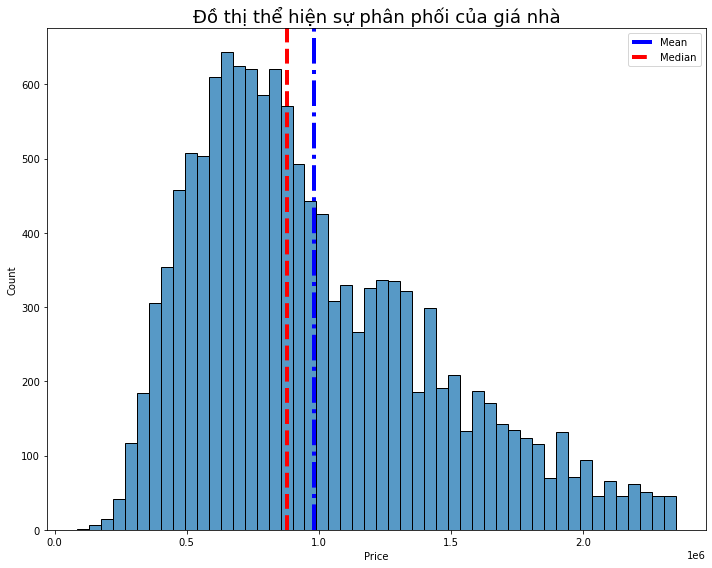

In [ ]:
plot(df, 'Price', title='Đồ thị thể hiện sự phân phối của giá nhà')

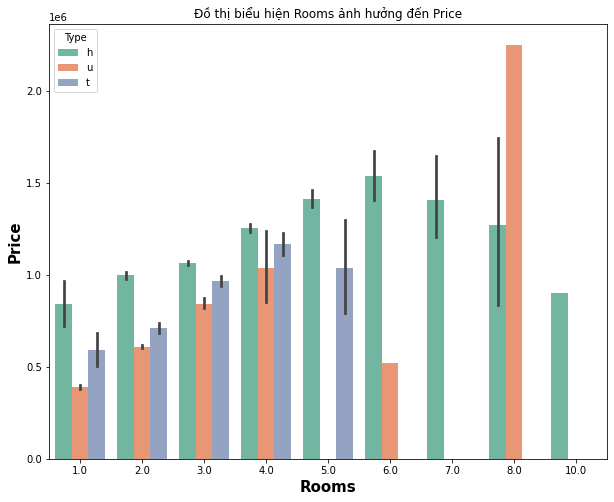

In [ ]:
plt.subplots(figsize=(10,8))
sns.barplot(x=df['Rooms'], y=df['Price'], hue=df['Type'], palette='Set2')
plt.xlabel('Rooms', weight='bold', fontsize=15)
plt.ylabel('Price', weight='bold', fontsize=15)
plt.title('Đồ thị biểu hiện Rooms ảnh hưởng đến Price')
plt.show()

Type:
- h : biệt thự, nhà vùng ngoại ô 
- u : nhà hai tầng
- t : nhà phố

Nhà vùng ngoại ô là sự lựa chọn của rất nhiều người nên có rất nhiều mức giá khác nhau dựa trên số lựa phòng trong 1 ngôi nhà. Đỉnh điểm là những ngôi nhà có 6 - 7 phòng có giá tương đối rất cao

Nhà hai tầng thì cũng được ưa chuộng. Số phòng càng nhiều thì giá nhà càng tăng. nhà có 8 phòng thì giá nhà sẽ rất là cao

Nhà trên phố cũng giống như nhà hai tầng giá nhà tăng đều

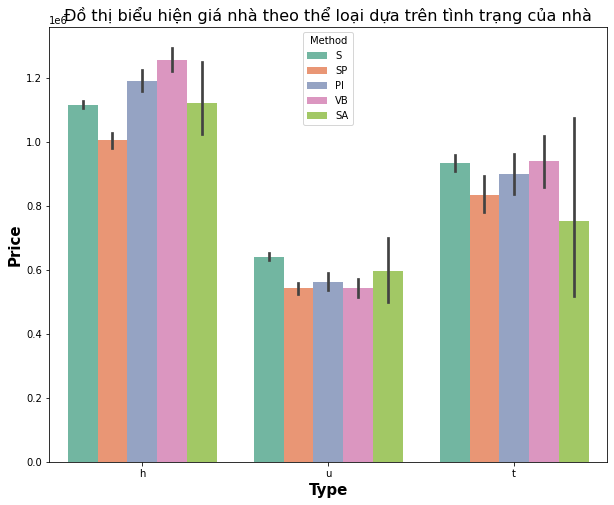

In [ ]:
plt.subplots(figsize=(10,8))
sns.barplot(x=df['Type'], y=df['Price'], hue=df['Method'], palette='Set2')
plt.xlabel('Type', weight='bold', fontsize=15)
plt.ylabel('Price', weight='bold', fontsize=15)
plt.title('Đồ thị biểu hiện giá nhà theo thể loại dựa trên tình trạng của nhà', fontsize=16)
plt.show()

**Chú thích:**
- S - property sold
- SP - property sold prior
- PI - property passed in
- VB - vendor bid
- SA - sold after auction

**Nhận xét:**
- Nhìn vào đồ thị chúng ta thấy được giá của nhà loại u (nhà hai tầng) tương đôi thấp và tình trạng của ngôi nhà cũng bằng nhau
- Cột h (nhà, biệt thự....) Gía nhà tương đối sẽ cao hơn các loại nhà khác. VB (giá của các nhà thầu cung cấp) tương đối cao
- Cột t đây là nhà phố thì giá cả tương đối phù hợp mọi người

Qua đây chúng ta nhìn ra ở cột có **METHOD** là **VB** ở các cột sẽ tương đối cao là do các nhà thầu, bất động sản đã đưa giá nhà lên rất cao 


In [ ]:
# def make_scatterplot(df, x, y, title, **kwargs):
#     plt.figure(figsize=(10, 5))
#     sns.scatterplot(data=df, x=x, y=y, **kwargs)
#     plt.title(title, fontsize=18)
#     plt.xlabel(x + ' advertising costs', fontsize=14)
#     plt.ylabel(y, fontsize=14)
#     #plt.xticks(rotation=90)
#     plt.show()

In [ ]:
# for col in df.columns[:-1]:
#     make_scatterplot(df, col, 'Price', title='Đồ thị phân tán  %s và Price' % (col))

In [ ]:
from datetime import datetime,date,timedelta

date = df[['Date','Price']].groupby('Date')['Price'].sum().reset_index()
#a = sorted([datetime.strptime(dt, "%d/%m/%Y ") for dt in date.Date])

date['Date'] =  date['Date'].astype('datetime64[ns]')
date.sort_values(by='Date', inplace=True)
date

,Date,Price
37,2016-01-28,2018000.0
43,2016-03-09,191479750.0
45,2016-03-12,283683299.0
47,2016-04-02,23612750.0
49,2016-04-06,194011600.0
13,2016-04-16,207072800.0
27,2016-04-23,84392950.0
10,2016-05-14,168612600.0
24,2016-05-22,183161350.0
38,2016-05-28,242451600.0


In [ ]:
px.line(date,x='Date', y="Price", title="Tổng giá nhà bán được theo ngày")

In [ ]:
plt.subplots(figsize=(20,6))
sns.barplot(x=df['Regionname'],y=df['Price'])
plt.xlabel('Regionname', weight='bold', fontsize=15)
plt.ylabel('Price', weight='bold', fontsize=15)
plt.title('Đồ thị biểu hiện giá nhà theo thể loại dựa trên khu vực', fontsize=16)
plt.show()

In [ ]:
seller = df[['SellerG','Price']].groupby('SellerG')['Price'].count().reset_index().rename(columns={'Price': 'Số lượng'})
seller = seller.sort_values(by='Số lượng',ascending=False).head(10)
seller

In [ ]:
f, ax = plt.subplots(figsize=(10, 5))
g = sns.barplot(data=seller, y='SellerG', x='Số lượng')
for p in g.patches:
    ax.annotate(
        format(p.get_width(), '.0f'),
        (p.get_width() + 0.15, p.get_y() + 0.5 * p.get_height()),
        ha='center', va='center', weight='bold'
    )
ax.grid(True, alpha=0.5, ls='-.')
ax.set_title('10 Đại lí bất động sản bán được nhiều nhà nhất', fontsize=15)
ax.set_xlabel('Số lượng', fontsize=12)
ax.set_ylabel('Seller', fontsize=12)
f.tight_layout()
plt.show()

Qua đây ta thấy được độ uy tín của các đại lí bất động sản 

Không phải những đại lí bán được ít thì uy tín thấp nhưng họ sẽ không được tin cậy cao bằng những đại lí thuộc top 100 trên đây

# Feature Selection

In [ ]:
print(categorical_features), len(categorical_features)

In [ ]:
print(numeric_features), len(numeric_features)

- Xóa bỏ thuộc tính có mức ý nghĩa thấp

In [ ]:
categorical_features = categorical_features.drop({'Regionname', 'Method'})

In [ ]:
numeric_features = numeric_features.drop({'Bedroom2'})

- Xóa bỏ các thuộc tính có quá nhiều loại dữ liệu ở biến caterogical featues

In [ ]:
categorical_features = categorical_features.drop({'Address', 'Date'})

**Lưu lại dữ liệu đã qua xử lí**

In [ ]:
df.to_csv('ppl.csv')
df

## LabelEncoder

- Tiến hành Encode cho các thuộc tính phân loại (categorical_features)

In [ ]:
#Encoding
for i in categorical_features:
    
    label_encoder = LabelEncoder()
    
    df[i] = label_encoder.fit_transform(df[i])

- Kết quả sau khi Encode

In [ ]:
df[categorical_features].head(5)

## Create new Training features

In [ ]:
training_features = list(numeric_features) + list(categorical_features)

In [ ]:
training_features, len(training_features)

# Scaling Dataset

- Nhằm cải thiện sự ổn định và hiệu suất của mô hình cúng tôi tiến hành Scaling Dataset

In [ ]:
minMaxNorm = MinMaxScaler()

minMaxNorm.fit(df[training_features])

- Gán dữ liệu chuẩn hóa cho biến X (Biến độc lập)

In [ ]:
X = minMaxNorm.transform(df[training_features])
X

- Gán dữ liệu chuẩn hóa cho biến Y (Biến phụ thuộc)

In [ ]:
Y = df['Price']
Y

# Chia train set và test set

In [ ]:
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state = 42)

In [ ]:
print('Total: ', df.shape[0])
print("Train set: ", X_train.shape, Y_train.shape)
print("Test set: ", X_test.shape, Y_test.shape)

# Model Building

## Linear Reression Model

In [ ]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error

In [ ]:
lr_model = LinearRegression()

lr_model.fit(X_train, Y_train)

lr_model_score = lr_model.score(X_test, Y_test )

lr_model_mae = mean_absolute_error(lr_model.predict(X_test), Y_test)

In [ ]:
print(lr_model_score.round(4))
print(lr_model_mae)

## Decision Tree Regressor Model

In [ ]:
from sklearn.tree import DecisionTreeRegressor

In [ ]:
Dtree_model = DecisionTreeRegressor(random_state=0)

Dtree_model.fit(X_train, Y_train)

Dtree_model_score = Dtree_model.score(X_test, Y_test )

Dtree_model_mae = mean_absolute_error(Dtree_model.predict(X_test), Y_test)

In [ ]:
print(Dtree_model_score.round(4))
print(Dtree_model_mae)

In [ ]:
n_feature = X.shape[1]
plt.figure(figsize=(15,10))

plt.barh(range(n_feature), Dtree_model.feature_importances_, align='center')

plt.yticks(np.arange(n_feature), df[training_features].columns)
plt.xlabel('Tầm quan trong')
plt.ylabel('Biến số')
plt.ylim(-1, n_feature)

## Random Forest Regressor Model

In [ ]:
from sklearn.ensemble import  RandomForestRegressor

In [ ]:
RFRModel = RandomForestRegressor(max_leaf_nodes=100, random_state=0)

RFRModel.fit(X_train, Y_train)

RFRModel_score = RFRModel.score(X_test, Y_test)

RFRModel_mae = mean_absolute_error(RFRModel.predict(X_test), Y_test)

In [ ]:
print(RFRModel_score.round(4))

print(RFRModel_mae)

## Bagging Regressor 

In [ ]:
from sklearn.ensemble import  BaggingRegressor

In [ ]:
BGR_model = BaggingRegressor()

BGR_model.fit(X_train, Y_train)

BGR_model_predicted = BGR_model.predict(X_test)

BGR_model_score = BGR_model.score(X_test, Y_test)

BGR_model_mae = mean_absolute_error(Y_test, BGR_model_predicted)

In [ ]:
print(BGR_model.score(X_test, Y_test))

print(mean_absolute_error(Y_test, BGR_model_predicted))


## XGBRegressor with Hyper Params Tunning

In [ ]:
from xgboost import XGBRegressor
from sklearn.model_selection import GridSearchCV

In [ ]:
xgbr_model = XGBRegressor()

params = {
    'n_estimators': [110, 120, 130, 140], 
    'learning_rate': [ 0.05, 0.075, 0.1],
    'max_depth': [ 7, 9],
    'reg_lambda': [0.3, 0.5]
}

xgb_reg = GridSearchCV(estimator=xgbr_model, param_grid=params, cv=5, n_jobs=-1)

xgb_reg.fit(X_train, Y_train)

xgbr_model_score = xgb_reg.best_score_

xgbr_model_pred = xgb_reg.predict(X_test)

mae = mean_absolute_error(Y_test, xgbr_model_pred)

print("Best score: %0.3f" % xgb_reg.best_score_)
print("Best parameters set:", xgb_reg.best_params_)

print("mean_absolute_error :", mae)

In [ ]:
fig = plt.figure(figsize=(20, 7))
x_ax = range(len(Y_test))
plt.plot(x_ax, Y_test, label="original")
plt.plot(x_ax, xgbr_model_pred, label="predicted")

plt.title("Realty data and Predict data")
plt.legend()
plt.show()

In [ ]:
fig, ax = plt.subplots(1,1, figsize=(10,10))
ax.plot(Y_test, xgbr_model_pred, '.', color='r')
randon_sample_price = np.linspace(np.min(df['Price']), np.max(df['Price']), 100)

# err = max_err - ((max_err+min_err)/2)
# y_err = randon_sample_price.std() * np.sqrt(1/len(randon_sample_price) + 
                                            # (randon_sample_price - randon_sample_price.mean())**2 / np.sum((randon_sample_price - randon_sample_price.mean())**2))

ax.plot(randon_sample_price, randon_sample_price, color='black')
ax.fill_between(randon_sample_price, randon_sample_price - randon_sample_price*0.15, randon_sample_price + randon_sample_price*0.15, alpha=0.5)

ax.set_xlabel("Actual")
ax.set_ylabel("Predicted")

# Deploy

In [ ]:
Y_test.head(5)

In [ ]:
arr_pre = X_test[[1]]

In [ ]:
print(arr_pre)

In [ ]:
xgb_reg.predict(arr_pre)